<a href="https://colab.research.google.com/github/GulnazaS/YOLOv11/blob/main/YOLOv11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Импорт библиотек, скачивание необходимых утилит и датасета

In [ ]:
!pip install ultralytics

In [1]:
import ultralytics

from ultralytics import YOLO
import os
from PIL import Image
import cv2
from IPython.display import Video
import glob
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')


ultralytics.checks()

Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 41.1/112.6 GB disk)


In [5]:
!wget https://storage.yandexcloud.net/academy.ai/CV/traffic_signs_detection.zip

--2025-04-26 21:21:32--  https://storage.yandexcloud.net/academy.ai/CV/traffic_signs_detection.zip
Resolving storage.yandexcloud.net (storage.yandexcloud.net)... 213.180.193.243, 2a02:6b8::1d9
Connecting to storage.yandexcloud.net (storage.yandexcloud.net)|213.180.193.243|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 104699644 (100M) [application/x-zip-compressed]
Saving to: ‘traffic_signs_detection.zip’

traffic_signs_detec 100%[===================>]  99.85M  20.3MB/s    in 5.9s    

2025-04-26 21:21:39 (16.9 MB/s) - ‘traffic_signs_detection.zip’ saved [104699644/104699644]



In [7]:
!unzip -qo "traffic_signs_detection.zip"

# Дообучение

In [16]:
yaml_path = '/content/car/data.yaml'

In [15]:
model = YOLO('yolo11s.pt')

In [17]:
results = model.train(
    data=yaml_path,   # путь к конфигурационному файлу
    epochs=15,        # число эпох
    batch=32,         # размер пакета
    imgsz=640,        # размер входного изображения
    plots= True       # сохранять графики
)

New https://pypi.org/project/ultralytics/8.3.118 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/car/data.yaml, epochs=15, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=Fals

100%|██████████| 755k/755k [00:00<00:00, 13.8MB/s]

Overriding model.yaml nc=80 with nc=15

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytic

 22                  -1  1   1511424  ultralytics.nn.modules.block.C3k2            [768, 512, 1, True]           
 23        [16, 19, 22]  1    825213  ultralytics.nn.modules.head.Detect           [15, [128, 256, 512]]         
YOLO11s summary: 181 layers, 9,433,597 parameters, 9,433,581 gradients, 21.6 GFLOPs

Transferred 493/499 items from pretrained weights
Freezing layer 'model.23.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 67.3MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 868.0±324.0 MB/s, size: 24.1 KB)


train: Scanning /content/car/train/labels... 3530 images, 3 backgrounds, 0 corrupt: 100%|██████████| 3530/3530 [00:01<00:00, 2589.59it/s]

train: New cache created: /content/car/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 547.4±331.4 MB/s, size: 20.7 KB)


val: Scanning /content/car/valid/labels... 801 images, 0 backgrounds, 0 corrupt: 100%|██████████| 801/801 [00:00<00:00, 909.75it/s]


val: New cache created: /content/car/valid/labels.cache
Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000526, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      7.96G     0.8658       3.71      1.185         33        640: 100%|██████████| 111/111 [01:11<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:09<00:00,  1.39it/s]


                   all        801        944      0.346      0.495      0.391      0.308

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      8.01G     0.7401      1.691      1.089         23        640: 100%|██████████| 111/111 [01:06<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.58it/s]

                   all        801        944      0.484      0.549      0.549      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      8.03G     0.7373      1.357      1.074         23        640: 100%|██████████| 111/111 [01:04<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.56it/s]

                   all        801        944      0.615      0.534      0.594      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15         8G     0.7355      1.216      1.079         29        640: 100%|██████████| 111/111 [01:04<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.54it/s]

                   all        801        944      0.672      0.662      0.726      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      8.04G     0.7127      1.085      1.055         22        640: 100%|██████████| 111/111 [01:04<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]

                   all        801        944      0.803      0.707      0.777      0.647


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      7.99G     0.6742      0.824      1.034         12        640: 100%|██████████| 111/111 [01:05<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.58it/s]

                   all        801        944      0.823      0.715      0.819       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      8.04G     0.6509     0.7674      1.007         14        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]

                   all        801        944      0.806      0.773      0.831      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      7.99G     0.6429      0.671      1.005         11        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]

                   all        801        944      0.897      0.788      0.882      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      8.04G      0.613      0.601     0.9784         16        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]

                   all        801        944      0.918      0.846      0.912      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      7.99G     0.6018     0.5412     0.9752         10        640: 100%|██████████| 111/111 [01:02<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]

                   all        801        944       0.93      0.836      0.927      0.785



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      8.04G     0.5862     0.4996     0.9656         10        640: 100%|██████████| 111/111 [01:02<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.60it/s]

                   all        801        944      0.934      0.842       0.93      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      7.99G     0.5714     0.4559     0.9535         10        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]

                   all        801        944       0.94      0.879      0.945      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      8.04G     0.5547     0.4298     0.9425         11        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]

                   all        801        944      0.939      0.902      0.953      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15         8G     0.5498     0.3957     0.9342         11        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]

                   all        801        944      0.929      0.909      0.954      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      8.04G     0.5323     0.3608     0.9308         12        640: 100%|██████████| 111/111 [01:02<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]

                   all        801        944      0.955      0.896      0.955      0.824



15 epochs completed in 0.306 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 19.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 19.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,418,605 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:12<00:00,  1.07it/s]


                   all        801        944      0.955      0.896      0.955      0.824
           Green Light         87        122      0.868        0.7      0.825      0.516
             Red Light         74        108      0.877      0.725      0.822      0.509
       Speed Limit 100         52         52       0.96      0.942      0.989      0.894
       Speed Limit 110         17         17      0.892      0.974      0.983      0.906
       Speed Limit 120         60         60          1      0.882      0.988        0.9
        Speed Limit 20         56         56      0.968      0.982       0.99       0.84
        Speed Limit 30         71         74      0.989      0.959      0.982      0.917
        Speed Limit 40         53         55      0.972      0.909      0.975       0.87
        Speed Limit 50         68         71       0.99      0.873      0.974      0.876
        Speed Limit 60         76         76      0.979      0.921      0.965      0.872
        Speed Limit 7

# Результаты

In [26]:
def result_train(path):
    img = cv2.imread(path)
    plt.figure(figsize=(10,10), dpi= 200)
    plt.imshow(img)

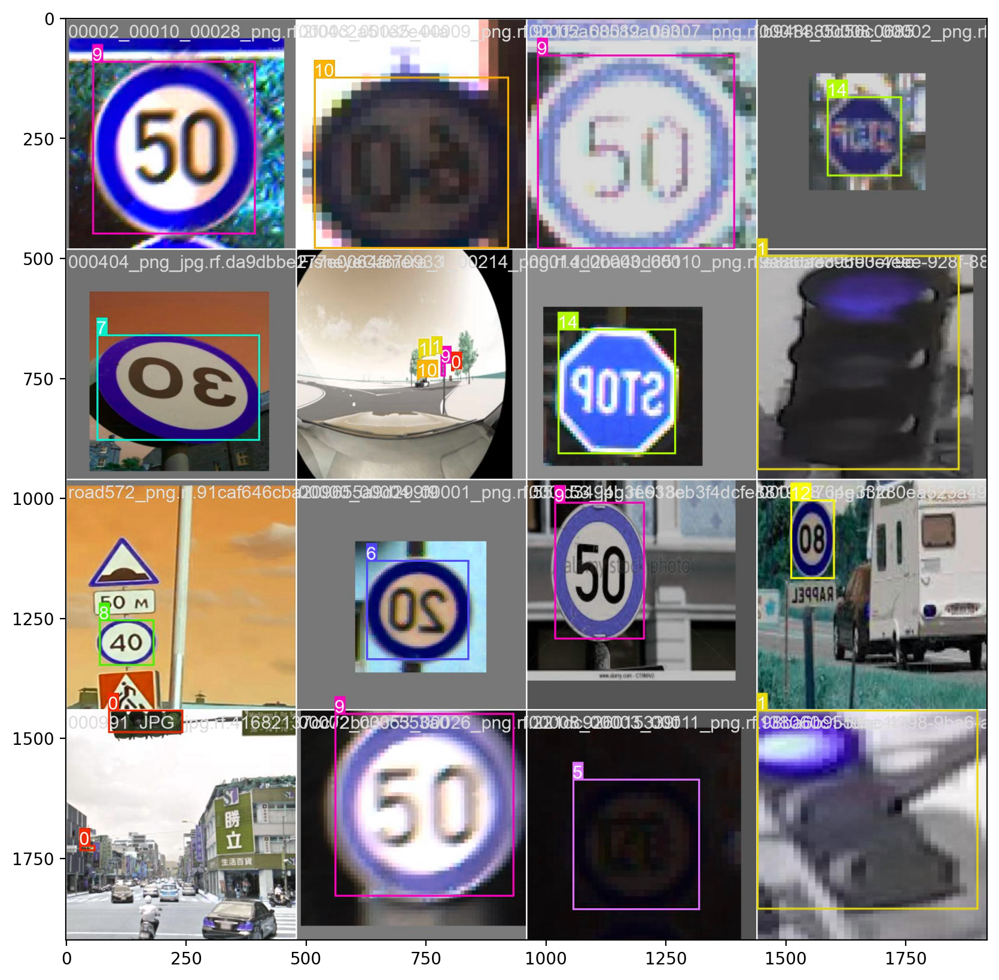

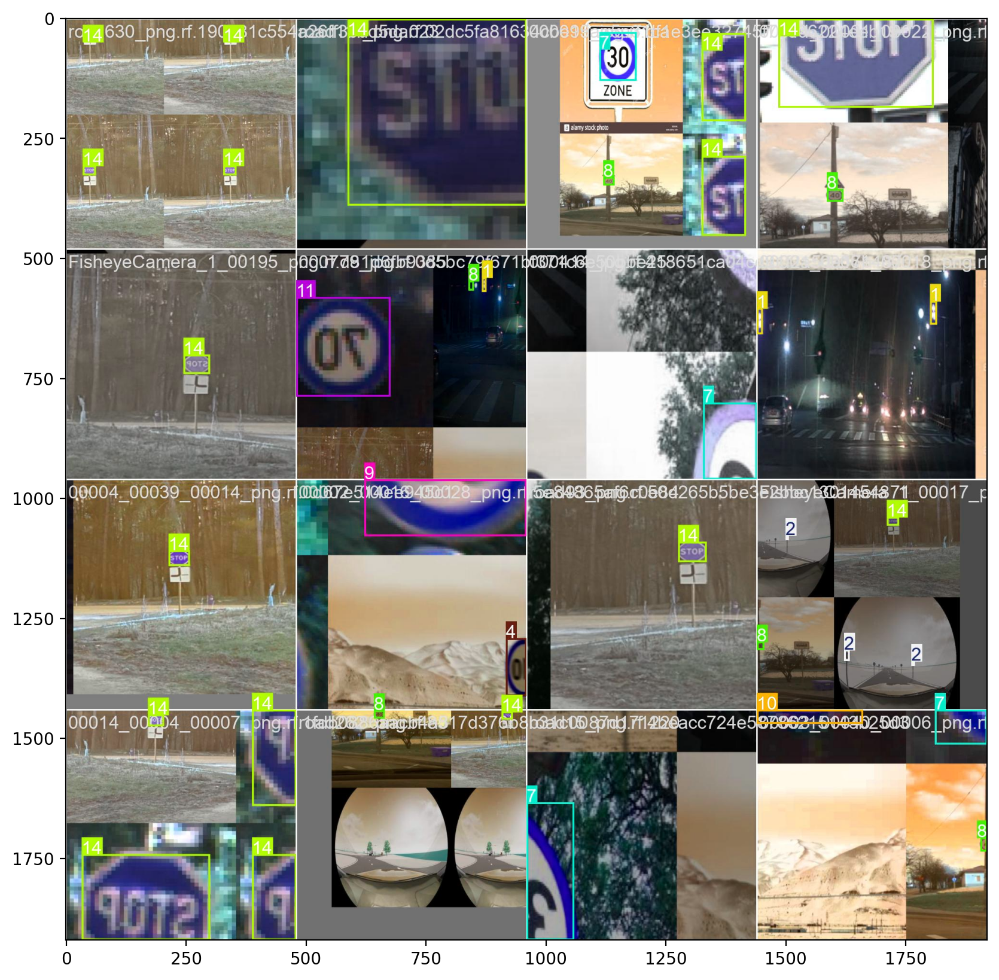

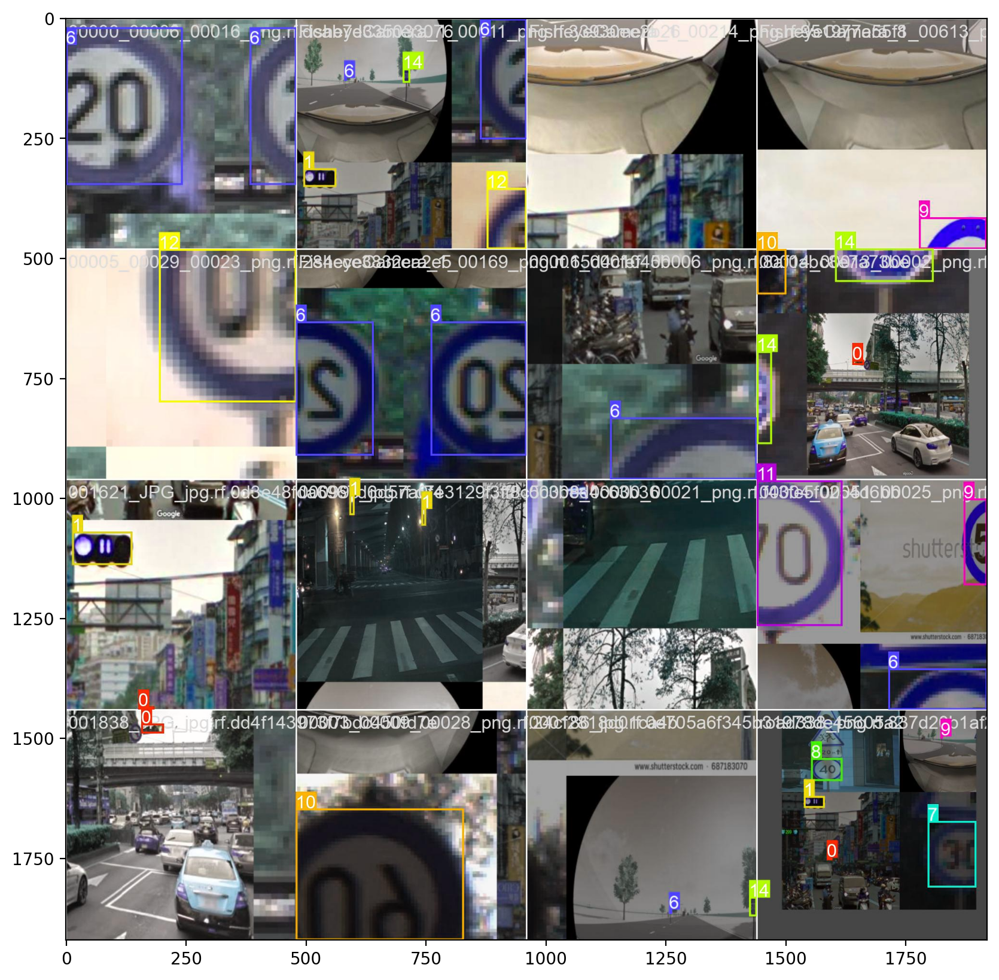

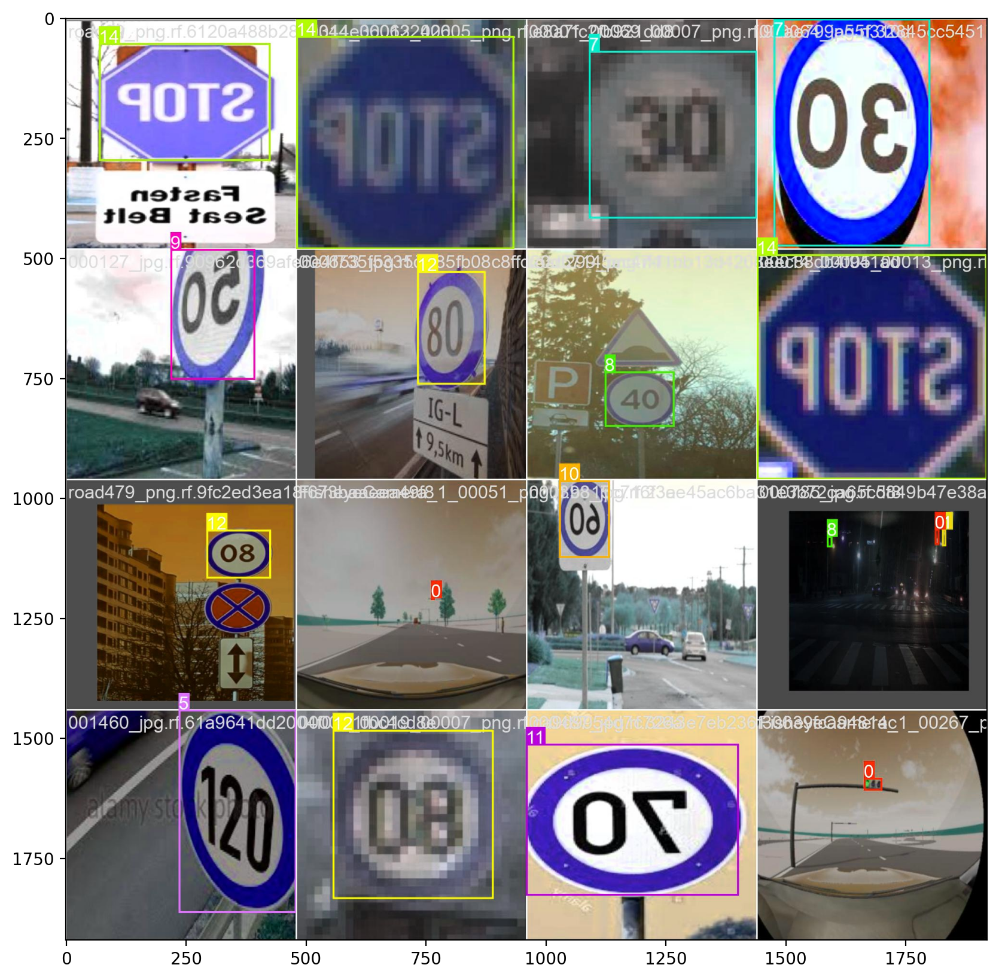

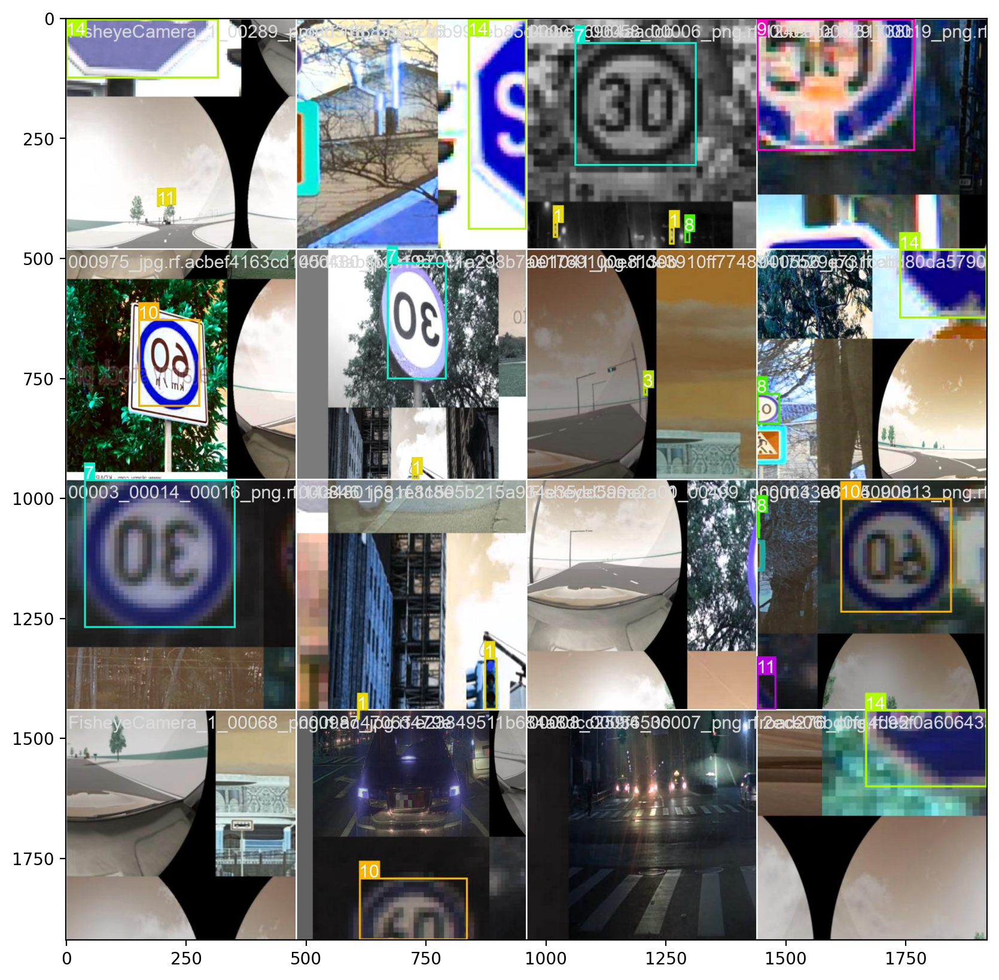

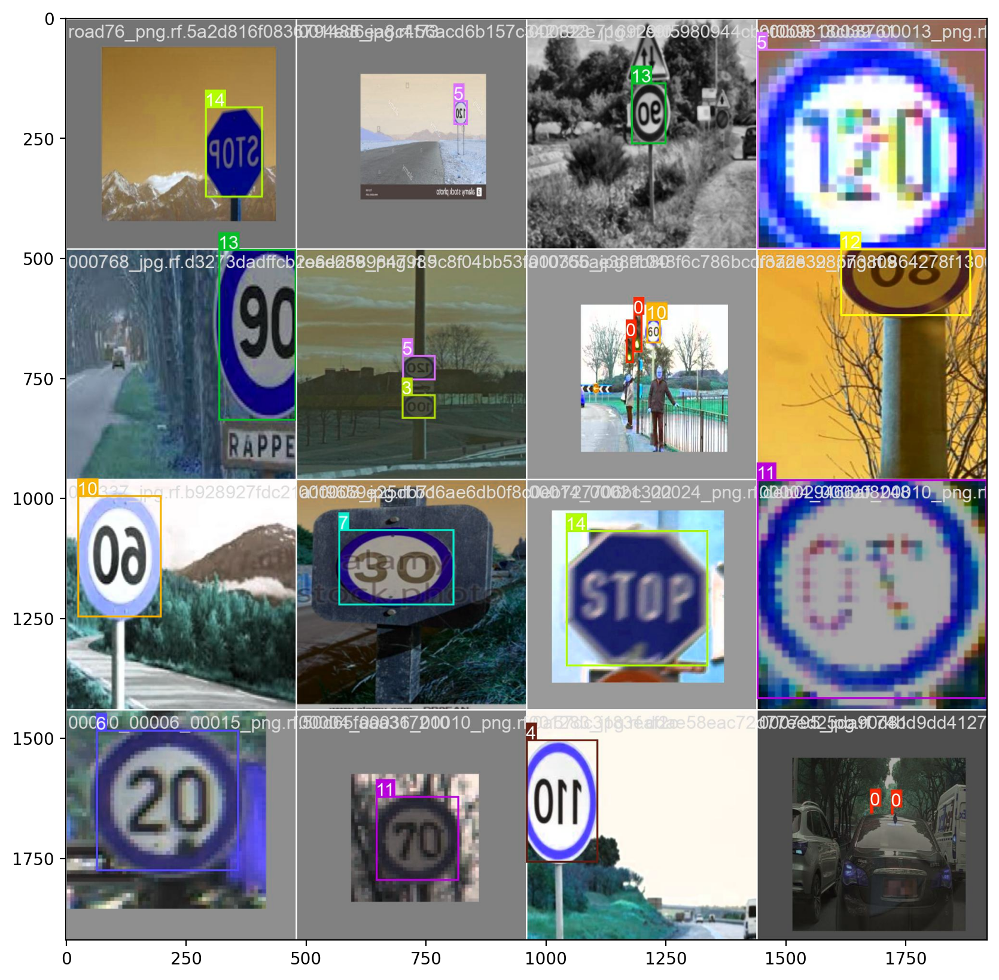

In [27]:
data_dir = "/content/runs/detect/train3"
img_dir = os.path.join(data_dir, 'train_batch*.jpg')
files = glob.glob(img_dir)
imgs = []
for image in files:
  result_train(image)

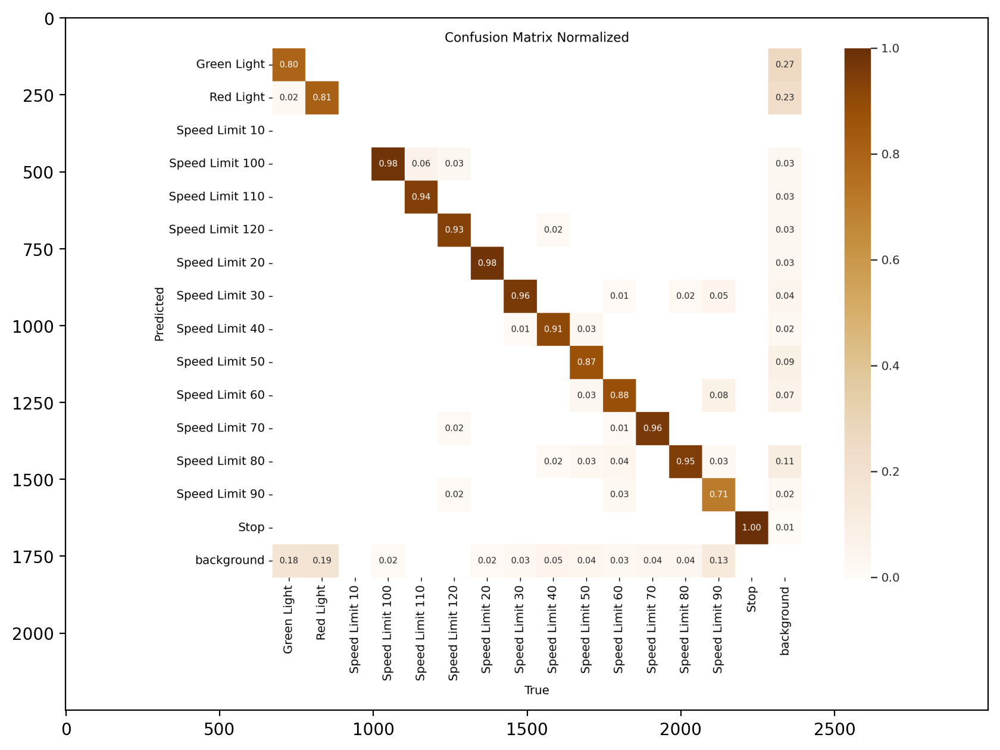

In [29]:
img_dir = os.path.join(data_dir, 'confusion_matrix_normalized.png')
result_train(img_dir)

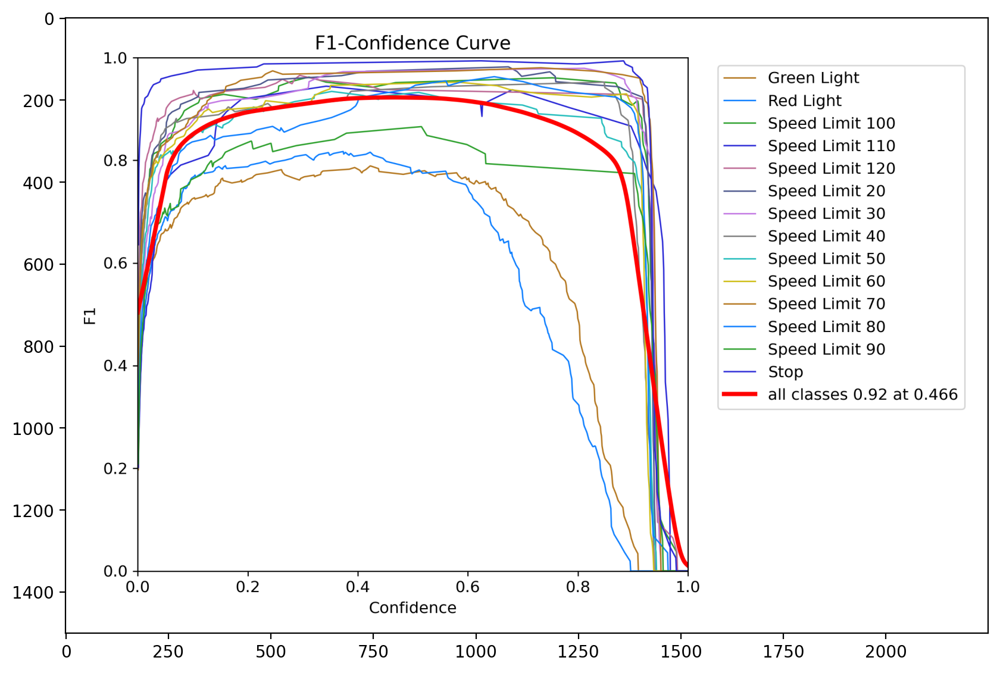

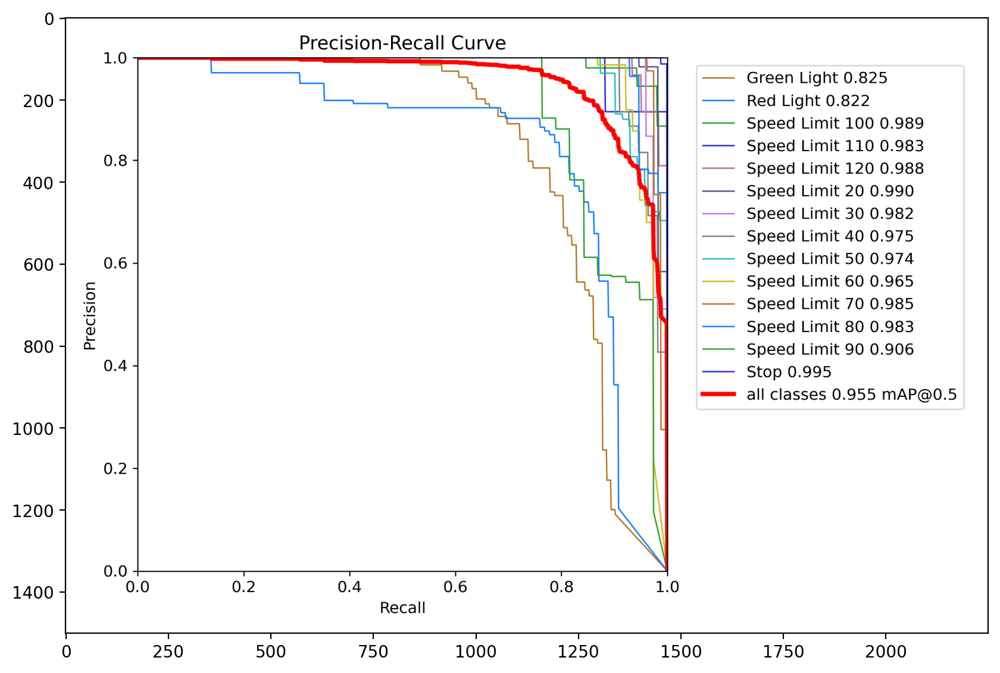

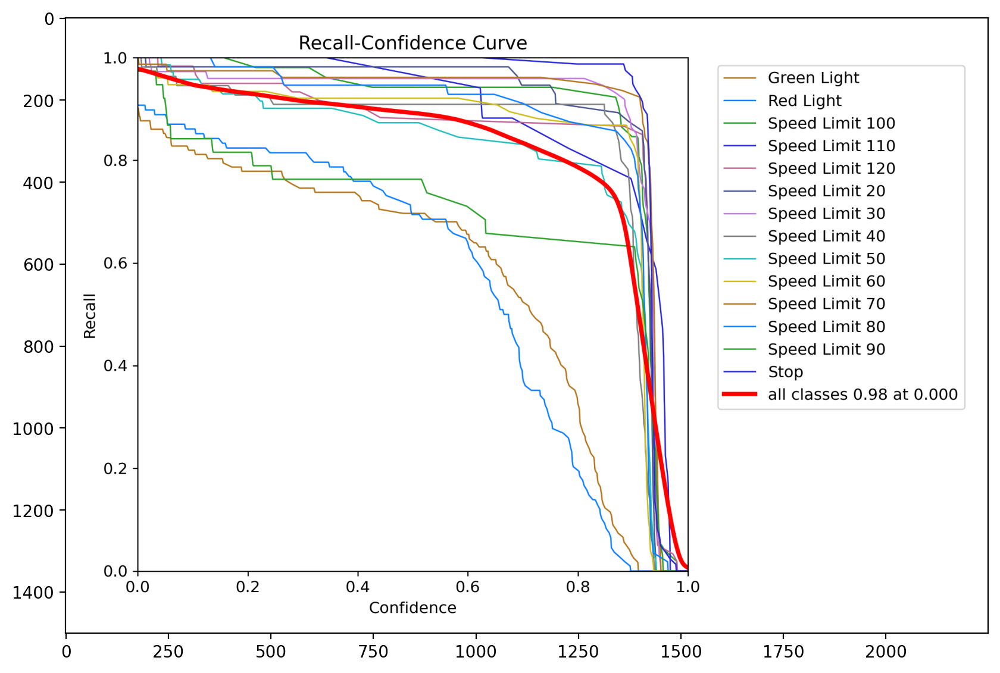

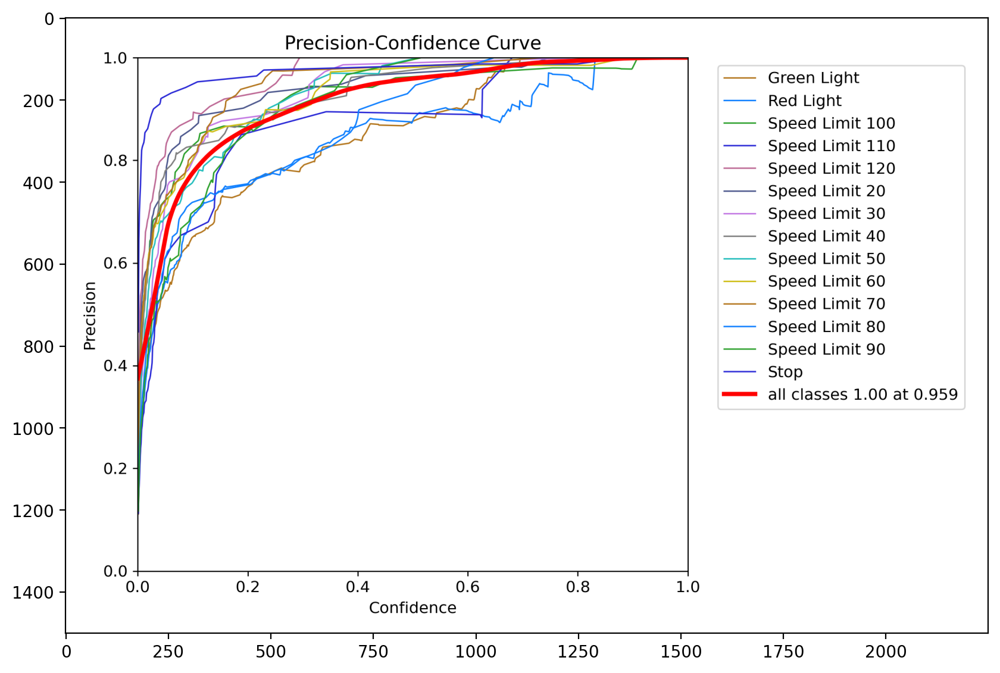

In [30]:
data_dir = "/content/runs/detect/train3"
img_dir = os.path.join(data_dir, '*curve*.png')
files = glob.glob(img_dir)
imgs = []
for image in files:
    result_train(image)

In [40]:
import random
test_dir = "/content/car/test/images"
img_dir = os.path.join(test_dir, '*.jpg')
files = glob.glob(img_dir)


image 1/1 /content/car/test/images/00000_00000_00013_png.rf.9076cbfc7f7811fa22547539a7e7ac02.jpg: 640x640 1 Speed Limit 20, 15.9ms
Speed: 4.5ms preprocess, 15.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/car/test/images/00004_00052_00006_png.rf.17e668414f18071d605e3327513528de.jpg: 640x640 1 Speed Limit 70, 15.6ms
Speed: 2.3ms preprocess, 15.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/car/test/images/road666_png.rf.7d914d9d62e7d0fcc23d5bce18bb5d3c.jpg: 640x640 1 Speed Limit 60, 15.6ms
Speed: 2.3ms preprocess, 15.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/car/test/images/00005_00001_00016_png.rf.da02434245fde3214475aa75e6d4e2b6.jpg: 640x640 1 Speed Limit 80, 15.7ms
Speed: 2.4ms preprocess, 15.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/car/test/images/001833_JPG_jpg.rf.b6092f0bd597484bb9c205017e5c389f.jpg: 64

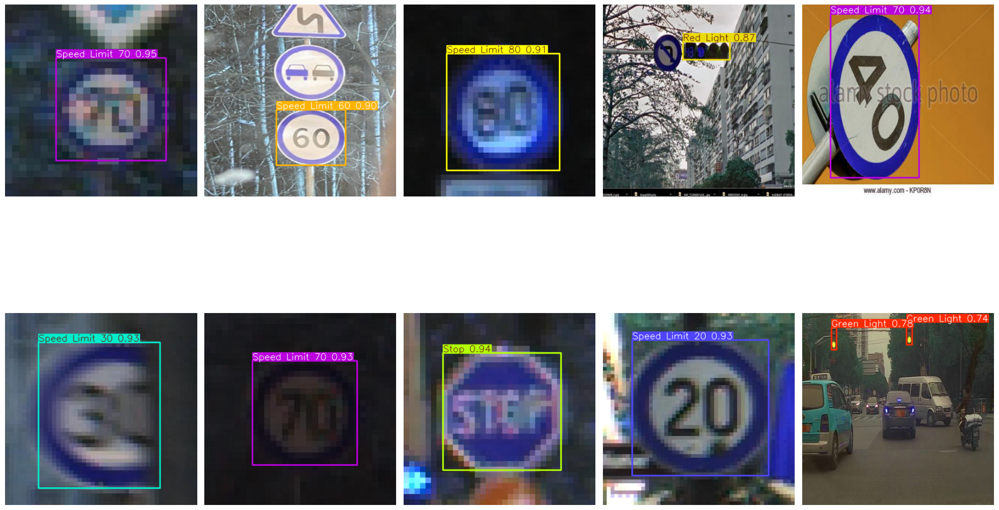

In [42]:
image_test_path = random.choice(files)

pred = model.predict(source=image_test_path,
                        imgsz=640)

# Выводим 10 изображений
plt.figure(figsize=(20, 15))
for i in range(10):
    # Выбираем случайное изображение
    image_test_path = random.choice(files)

    # Делаем предсказание
    pred = model.predict(source=image_test_path, imgsz=640)

    # Подготовка изображения с предсказаниями
    test_image = pred[0].plot(line_width=2)

    # Вывод изображения без осей
    plt.subplot(2, 5, i+1)
    plt.imshow(test_image)
    plt.axis('off')  # Отключаем оси координат

plt.tight_layout()
plt.show()